In [1]:
# THIS WORKS, DON'T TOUCH IT

# reference:  https://community.plotly.com/t/cumulative-lines-animation-in-python/25707/2
import numpy as np
import pandas as pd
import plotly.graph_objects as go  #plotly 4.0.0rc1


df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/finance-charts-apple.csv')
low = df['AAPL.Low'].tolist()
#high = np.array(df['AAPL.High'])+20 # artificially added 20 to get the second graph above the first one
high = df['AAPL.High'].tolist()
timeval = "Date"


df[timeval]
low
high
print(len(low))
print(len(high))
print(type(low))
print(type(high))
print(min(low))
print(max(low))
print(min(high))
print(max(high))

min_low = min(low)
max_high = max(high)

print(min_low)
print(max_high)

506
506
<class 'list'>
<class 'list'>
89.470001
134.839996
91.669998
136.270004
89.470001
136.270004


In [7]:
df.head()

,Date,Open,High,Low,Close,Volume,Adjusted,dn,mavg,up,direction
0,2015-02-17,127.489998,128.880005,126.919998,127.830002,63152400,122.905254,106.741052,117.927667,129.114281,Increasing
1,2015-02-18,127.629997,128.779999,127.449997,128.720001,44891700,123.760965,107.842423,118.940333,130.038244,Increasing
2,2015-02-19,128.479996,129.029999,128.330002,128.449997,37362400,123.501363,108.894245,119.889167,130.884089,Decreasing
3,2015-02-20,128.619995,129.500000,128.050003,129.500000,48948400,124.510914,109.785449,120.763500,131.741551,Increasing
4,2015-02-23,130.020004,133.000000,129.660004,133.000000,70974100,127.876074,110.372516,121.720167,133.067817,Increasing


In [5]:
df["Date"][:2]

0    2015-02-17
1    2015-02-18
Name: Date, dtype: object

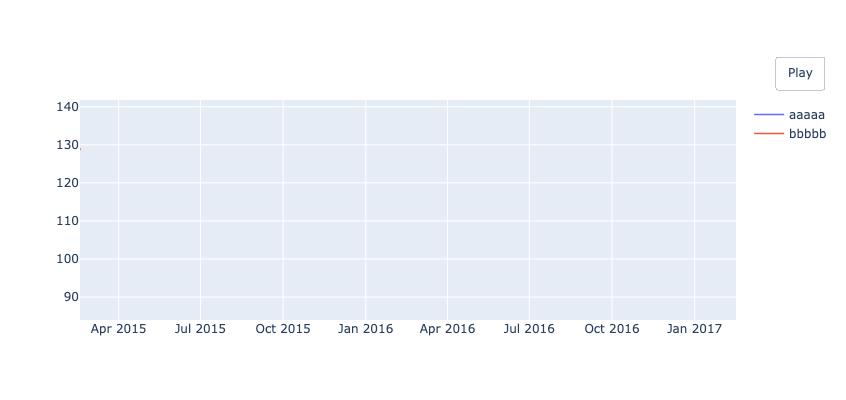

In [6]:
trace1 = go.Scatter(x=df[timeval][:2],
                    y=low[:2],
                    mode='lines',
                    line=dict(width=1.5),
                   name="aaaaa")

trace2 = go.Scatter(x = df[timeval][:2],
                    y = high[:2],
                    mode='lines',
                    line=dict(width=1.5),
                   name="bbbbb")

increment = 50
frames = [dict(data= [dict(type='scatter',
                           x=df[timeval][:k+increment],
                           y=low[:k+increment]),
                      dict(type='scatter',
                           x=df[timeval][:k+increment],
                           y=high[:k+increment])],
               traces= [0, 1],  # frames[k]['data'][0]  updates trace1, and   frames[k]['data'][1], trace2 
              )
          for k  in  range(1, len(low)-1)] 

layout = go.Layout(width=650,
                   height=400,
                   showlegend=True,
                   hovermode='closest',
                   updatemenus=[dict(type='buttons', showactive=False,
                                y=1.05,
                                x=1.15,
                                xanchor='right',
                                yanchor='bottom',
                                pad=dict(t=0, r=10),
                                buttons=[dict(label='Play',
                                              method='animate',
                                              args=[None, 
                                                    dict(frame=dict(duration=0.5, 
                                                                    redraw=False),
                                                         transition=dict(duration=0),
                                                         fromcurrent=True,
                                                         mode='immediate')])])])


layout.update(xaxis =dict(range=[df[timeval][0], df[timeval][len(df)-1]], autorange=False),
              yaxis =dict(range=[min_low-5.5, max_high+5.5], autorange=False));

fig = go.Figure(data=[trace1, trace2], frames=frames, layout=layout)

fig.show()

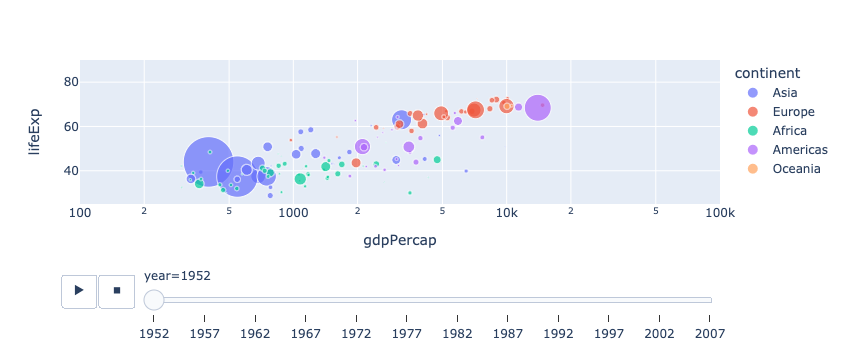

In [16]:
import plotly.express as px
df = px.data.gapminder()
px.scatter(df, x="gdpPercap", y="lifeExp", animation_frame="year", animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

In [14]:
# Example 
import plotly.express as px
df = px.data.gapminder()
df

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4
4,Afghanistan,Asia,1972,36.088,13079460,739.981106,AFG,4
...,...,...,...,...,...,...,...,...
1699,Zimbabwe,Africa,1987,62.351,9216418,706.157306,ZWE,716
1700,Zimbabwe,Africa,1992,60.377,10704340,693.420786,ZWE,716
1701,Zimbabwe,Africa,1997,46.809,11404948,792.449960,ZWE,716
1702,Zimbabwe,Africa,2002,39.989,11926563,672.038623,ZWE,716


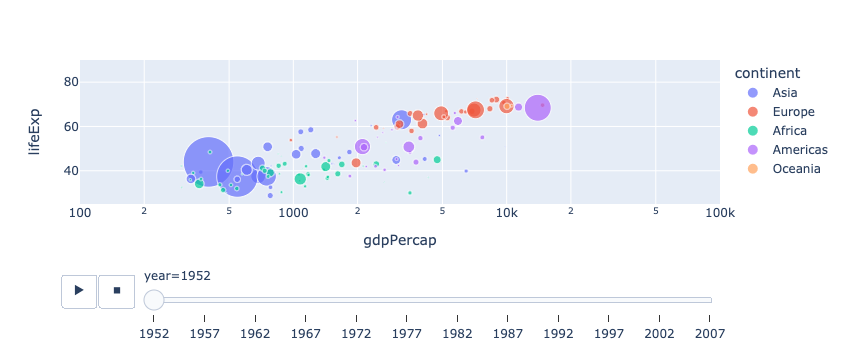

In [15]:

px.scatter(df, x="gdpPercap", y="lifeExp", animation_frame="year", animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

In [2]:
df = px.data.gapminder()
#df.head()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1704 entries, 0 to 1703
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   country    1704 non-null   object 
 1   continent  1704 non-null   object 
 2   year       1704 non-null   int64  
 3   lifeExp    1704 non-null   float64
 4   pop        1704 non-null   int64  
 5   gdpPercap  1704 non-null   float64
 6   iso_alpha  1704 non-null   object 
 7   iso_num    1704 non-null   int64  
dtypes: float64(2), int64(3), object(3)
memory usage: 106.6+ KB


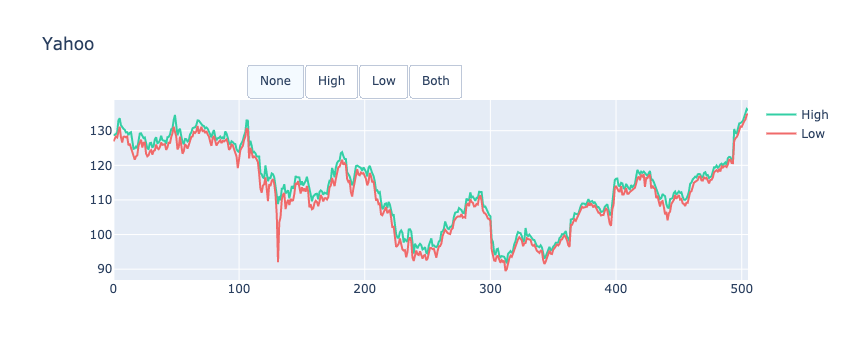

In [3]:
import plotly.graph_objects as go

import pandas as pd

# Load dataset
df = pd.read_csv(
    "https://raw.githubusercontent.com/plotly/datasets/master/finance-charts-apple.csv")
df.columns = [col.replace("AAPL.", "") for col in df.columns]

# Initialize figure
fig = go.Figure()

# Add Traces

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=list(df.High),
               name="High",
               line=dict(color="#33CFA5")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=[df.High.mean()] * len(df.index),
               name="High Average",
               visible=False,
               line=dict(color="#33CFA5", dash="dash")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=list(df.Low),
               name="Low",
               line=dict(color="#F06A6A")))

fig.add_trace(
    go.Scatter(x=list(df.index),
               y=[df.Low.mean()] * len(df.index),
               name="Low Average",
               visible=False,
               line=dict(color="#F06A6A", dash="dash")))

# Add Annotations and Buttons
high_annotations = [dict(x="2016-03-01",
                         y=df.High.mean(),
                         xref="x", yref="y",
                         text="High Average:<br> %.2f" % df.High.mean(),
                         ax=0, ay=-40),
                    dict(x=df.High.idxmax(),
                         y=df.High.max(),
                         xref="x", yref="y",
                         text="High Max:<br> %.2f" % df.High.max(),
                         ax=0, ay=-40)]
low_annotations = [dict(x="2015-05-01",
                        y=df.Low.mean(),
                        xref="x", yref="y",
                        text="Low Average:<br> %.2f" % df.Low.mean(),
                        ax=-40, ay=40),
                   dict(x=df.High.idxmin(),
                        y=df.Low.min(),
                        xref="x", yref="y",
                        text="Low Min:<br> %.2f" % df.Low.min(),
                        ax=0, ay=40)]

fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="right",
            active=0,
            x=0.57,
            y=1.2,
            buttons=list([
                dict(label="None",
                     method="update",
                     args=[{"visible": [True, False, True, False]},
                           {"title": "Yahoo",
                            "annotations": []}]),
                dict(label="High",
                     method="update",
                     args=[{"visible": [True, True, False, False]},
                           {"title": "Yahoo High",
                            "annotations": high_annotations}]),
                dict(label="Low",
                     method="update",
                     args=[{"visible": [False, False, True, True]},
                           {"title": "Yahoo Low",
                            "annotations": low_annotations}]),
                dict(label="Both",
                     method="update",
                     args=[{"visible": [True, True, True, True]},
                           {"title": "Yahoo",
                            "annotations": high_annotations + low_annotations}]),
            ]),
        )
    ])

# Set title
fig.update_layout(
    title_text="Yahoo",
    xaxis_domain=[0.05, 1.0]
)

fig.show()

In [1]:
import plotly.graph_objects as go

trace = go.Heatmap(z=[[1, 20, 30, 50, 1], [20, 1, 60, 80, 30], [30, 60, 1, -10, 20]],
                   x=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'],
                   y=['Morning', 'Afternoon', 'Evening'])
data=[trace]
layout = go.Layout(title='Activity Heatmap')

figure = go.Figure(data=data, layout=layout)

f2 = go.FigureWidget(figure)
f2

ImportError: Please install ipywidgets>=7.0.0 to use the FigureWidget class

In [8]:
!pip install ipywidgets>=7.0.0

zsh:1: 7.0.0 not found


In [7]:
!pip install --upgrade pip

     |████████████████████████████████| 1.6 MB 4.8 MB/s eta 0:00:01
  Attempting uninstall: pip
    Found existing installation: pip 21.2.3
    Uninstalling pip-21.2.3:
      Successfully uninstalled pip-21.2.3
